## ***Project 3***

**Mapping the Landscape of Generative AI Research through
Web of Science**

In [2]:
# Mount drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Set working directory
%cd /content/drive/MyDrive/NEU-MS-DAE/IE6400-FDA/Project3

/content/drive/MyDrive/NEU-MS-DAE/IE6400-FDA/Project3


In [4]:
# Import necessary headers
import pandas as pd
import os
import re
import networkx as nx
import matplotlib.pyplot as plt
import itertools
import numpy as np

In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
import re
import heapq

***Task 1: Comprehensive Literature Retrieval***

1. Web of Science: Snell Library Database
2. Downloaded articles of the search result using "Generative AI" keyword search
3. Considered the articles published in 2023

In [6]:
# Read all the 2k articles
xlsx_folder_path = '/content/drive/MyDrive/NEU-MS-DAE/IE6400-FDA/Project3/ExportedData'
xlsx_files = [f for f in os.listdir(xlsx_folder_path) if f.endswith('.xls')]

In [7]:
dfs=[]
for i, excel in enumerate(xlsx_files):
    df = pd.read_excel(os.path.join(xlsx_folder_path, excel))
    dfs.append(df)

In [8]:
df = pd.concat(dfs, ignore_index=True)

In [9]:
df.columns

Index(['Publication Type', 'Authors', 'Book Authors', 'Book Editors',
       'Book Group Authors', 'Author Full Names', 'Book Author Full Names',
       'Group Authors', 'Article Title', 'Source Title', 'Book Series Title',
       'Book Series Subtitle', 'Language', 'Document Type', 'Conference Title',
       'Conference Date', 'Conference Location', 'Conference Sponsor',
       'Conference Host', 'Author Keywords', 'Keywords Plus', 'Abstract',
       'Addresses', 'Affiliations', 'Reprint Addresses', 'Email Addresses',
       'Researcher Ids', 'ORCIDs', 'Funding Orgs', 'Funding Name Preferred',
       'Funding Text', 'Cited References', 'Cited Reference Count',
       'Times Cited, WoS Core', 'Times Cited, All Databases',
       '180 Day Usage Count', 'Since 2013 Usage Count', 'Publisher',
       'Publisher City', 'Publisher Address', 'ISSN', 'eISSN', 'ISBN',
       'Journal Abbreviation', 'Journal ISO Abbreviation', 'Publication Date',
       'Publication Year', 'Volume', 'Issue', 'Pa

In [10]:
# Give a new column for the article number
df['Article Num'] = df.index
df = df[['Author Keywords', 'Article Num']]
cols = df.columns.tolist()
cols = ['Article Num', 'Author Keywords']
df = df[cols]

In [11]:
df

,Article Num,Author Keywords
0,0,HCI; AI; Generative AI; Human-AI Interaction
1,1,Legal; Law; Explainable AI; Blockchain; Genera...
2,2,AI governance; AI regulation; generative AI; g...
3,3,Speculative Design; Generative AI; Creativity;...
4,4,Generative AI; innovation diffusion; TOE frame...
...,...,...
2007,2007,eHealth; behavioral change; mobile phone; smar...
2008,2008,algorithms; big data; corporate empiricism; pe...
2009,2009,Skin lesion; Deep learning; Segmentation; Survey
2010,2010,NaN


In [12]:
# Remove the articles that has no author keywords
df = df[df['Author Keywords'].notna()]

In [13]:
df

,Article Num,Author Keywords
0,0,HCI; AI; Generative AI; Human-AI Interaction
1,1,Legal; Law; Explainable AI; Blockchain; Genera...
2,2,AI governance; AI regulation; generative AI; g...
3,3,Speculative Design; Generative AI; Creativity;...
4,4,Generative AI; innovation diffusion; TOE frame...
...,...,...
2006,2006,survey; recommender systems; graph neural netw...
2007,2007,eHealth; behavioral change; mobile phone; smar...
2008,2008,algorithms; big data; corporate empiricism; pe...
2009,2009,Skin lesion; Deep learning; Segmentation; Survey


In [14]:
df['Author Keywords']

0            HCI; AI; Generative AI; Human-AI Interaction
1       Legal; Law; Explainable AI; Blockchain; Genera...
2       AI governance; AI regulation; generative AI; g...
3       Speculative Design; Generative AI; Creativity;...
4       Generative AI; innovation diffusion; TOE frame...
                              ...                        
2006    survey; recommender systems; graph neural netw...
2007    eHealth; behavioral change; mobile phone; smar...
2008    algorithms; big data; corporate empiricism; pe...
2009     Skin lesion; Deep learning; Segmentation; Survey
2011    beta-oxidation; fatty acid; fetal sex; gestati...
Name: Author Keywords, Length: 1611, dtype: object

***Task 2: Keyword Co-Occurrence Network Analysis***

1. Cleaning the dataset with NLTK
- Converting Text to Lowercase
- Removing Special Characteristics
- Removing Numbers
- Text Tokenization
- Removing Stopwords
- Lemmatization of Words


In [15]:
# Download stopwords and wordnet for further text cleaning
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [16]:
# Clean the text
def clean_text(text):
    # Convert text to lowercase
    text = text.lower()

    # Remove special characters
    text = re.sub(r'[^\w\s;]', '', text)

    # Remove numbers
    text = re.sub(r'\d+', '', text)

    # Tokenize the text
    tokens = word_tokenize(text)

    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word not in stop_words]

    # Lemmatize words
    lemmatizer = WordNetLemmatizer()
    lemmatized_tokens = [lemmatizer.lemmatize(word) for word in filtered_tokens]

    return ' '.join(lemmatized_tokens)

def clean_dataframe(df, column_name):
    df[column_name] = df[column_name].apply(clean_text)
    return df

In [17]:
df = clean_dataframe(df, 'Author Keywords')

<ipython-input-16-621e56f82e06>:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column_name] = df[column_name].apply(clean_text)


In [18]:
df

,Article Num,Author Keywords
0,0,hci ; ai ; generative ai ; humanai interaction
1,1,legal ; law ; explainable ai ; blockchain ; ge...
2,2,ai governance ; ai regulation ; generative ai ...
3,3,speculative design ; generative ai ; creativit...
4,4,generative ai ; innovation diffusion ; toe fra...
...,...,...
2006,2006,survey ; recommender system ; graph neural net...
2007,2007,ehealth ; behavioral change ; mobile phone ; s...
2008,2008,algorithm ; big data ; corporate empiricism ; ...
2009,2009,skin lesion ; deep learning ; segmentation ; s...


2. Building the weighed graph
- Split the keywords using the delimited ';'
- For each keyword pair in the article, whenever the keyword occurs in another article, the weight increases
- Converting the graph to adjacency matrix, with the weight for the keyword to itself being 0.
- Finally, creating a result dataset containing the source, target and the corresponding weight

In [19]:
# Start building the graph with Author Keywords
formatted_lines = df['Author Keywords'].tolist()

# Tokenize the lists
tokenized_lists = [list_.split(' ; ') for list_ in formatted_lines]

# Build co-occurrence network
G = nx.Graph()

for list_ in tokenized_lists:
    for item1, item2 in itertools.combinations(set(list_), 2):
        if G.has_edge(item1, item2):
            G[item1][item2]['weight'] += 1
        else:
            G.add_edge(item1, item2, weight=1)

In [ ]:
len(G.edges(data=True))

24898

In [20]:
# Convert the graph to adjacency matrix
adj_matrix = nx.to_numpy_array(G, weight='weight')

# Get the nodes list
nodes = G.nodes()

# Create DataFrame from adjacency matrix
adj_df = pd.DataFrame(adj_matrix.round().astype(int), index=nodes, columns=nodes)

In [21]:
adj_df

,ai,humanai interaction,hci,generative ai,responsible ai,blockchain,law,legal,explainable ai,inspectability,...,proxy,theory,corporate empiricism,scaling,placental metabolism,gestational diabetes,betaoxidation,stable isotope,fetal sex,fatty acid
ai,0,1,1,12,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
humanai interaction,1,0,1,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
hci,1,1,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
generative ai,12,4,1,0,5,1,2,1,2,1,...,0,0,0,0,0,0,0,0,0,0
responsible ai,0,0,0,5,0,1,1,1,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
gestational diabetes,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,0,1,1,1,1
betaoxidation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,1,1,1
stable isotope,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,1,0,1,1
fetal sex,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,1,1,0,1


In [22]:
adj_df['artificial intelligence'].sort_values()

lowvoltage circuit breaker lvcb      0
psm                                  0
artificial sea ice image             0
sea ice concentration                0
geometric preference                 0
                                  ... 
ai                                  48
machine learning                    51
large language model                64
generative ai                       67
chatgpt                            169
Name: artificial intelligence, Length: 4865, dtype: int64

In [23]:
edges_data = [(u, v, d['weight']) for u, v, d in G.edges(data=True)]
edges_df = pd.DataFrame(edges_data, columns=['Source', 'Target', 'Weight'])
edges_df_sorted = edges_df.sort_values(by='Weight', ascending=False)
edges_df_sorted

,Source,Target,Weight
2830,chatgpt,artificial intelligence,169
433,generative ai,chatgpt,90
480,generative ai,artificial intelligence,67
1855,large language model,chatgpt,67
1863,large language model,artificial intelligence,64
...,...,...,...
8984,data augmentation,open science,1
8983,data augmentation,ecg synthesis,1
8982,data augmentation,data sharing,1
8981,data augmentation,data scarcity,1


In [28]:
edges_df_sorted.head(50)

,Source,Target,Weight
2830,chatgpt,artificial intelligence,169
433,generative ai,chatgpt,90
480,generative ai,artificial intelligence,67
1855,large language model,chatgpt,67
1863,large language model,artificial intelligence,64
417,generative ai,large language model,60
5337,artificial intelligence,machine learning,51
13,ai,artificial intelligence,48
2815,chatgpt,gpt,42
18,ai,chatgpt,42


3. Visualization
- A Bar-Graph Representing the top 30 keyword pairs, sorted by its weight
  - gives the most used keywords, further giving insights into the Gen-AI landscape
- Generative AI Related Keyword Co-occurrence Network
  - Gives the visualisation of the graph, node represents keywords, weight represents the association.
  - For nodes with weight greater than 1
  - For top 100 nodes
- Average strength (average weight) for each node

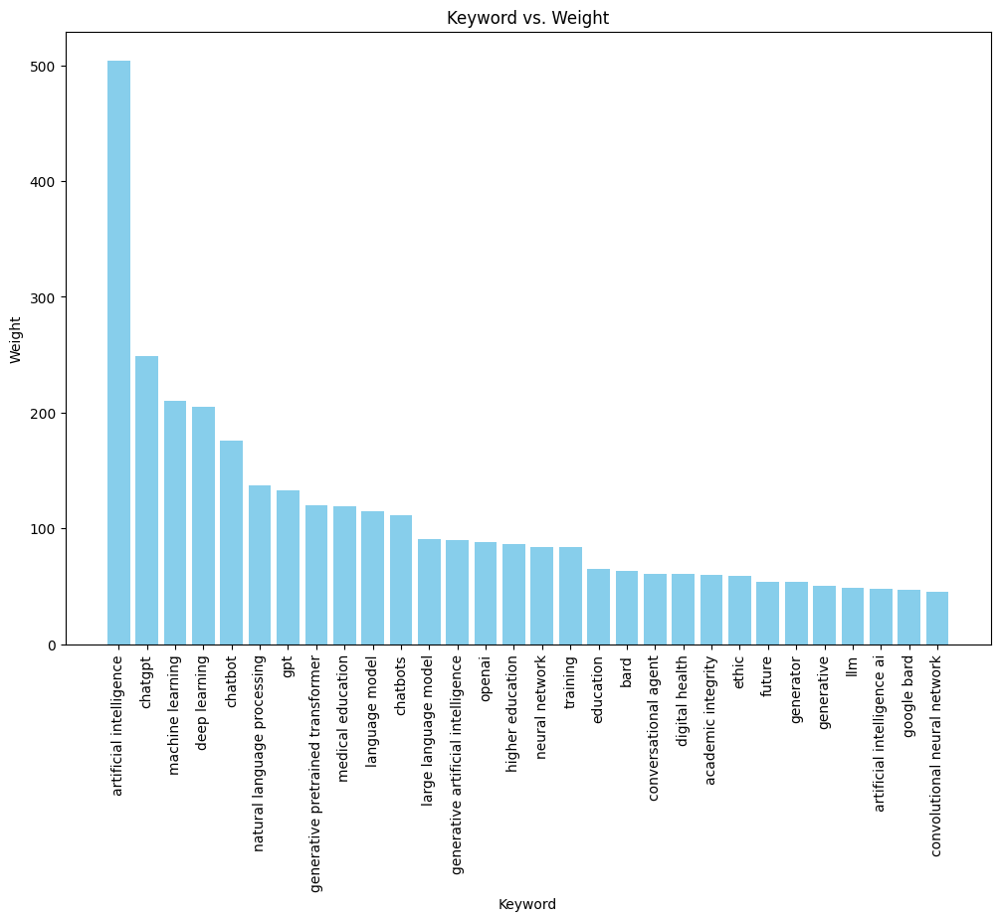

In [39]:
# Sort the DataFrame by weights in descending order
sorted_df = edges_df_sorted.groupby('Target')['Weight'].sum().nlargest(30)
# Plot the bar graph
plt.figure(figsize=(12, 8))
plt.bar(sorted_df.index, sorted_df.values, color='skyblue')
plt.title('Keyword vs. Weight')
plt.xlabel('Keyword')
plt.ylabel('Weight')
plt.xticks(rotation=90)
plt.show()

In [ ]:
# Visualization with weighted edges
pos = nx.spring_layout(G, k=0.5)

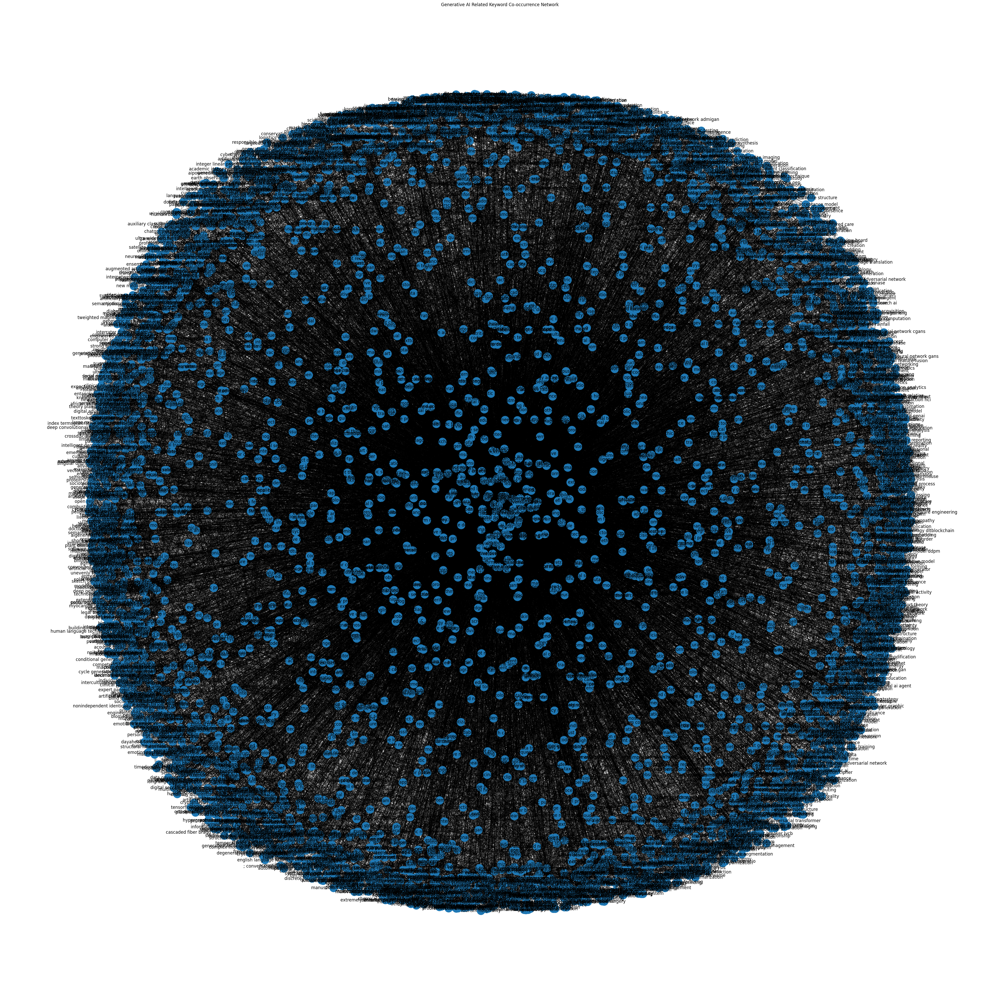

In [ ]:
# Nodes
plt.figure(figsize=(50, 50))
nx.draw_networkx_nodes(G, pos, node_size=500)

# Edges
edges = G.edges(data=True)
edge_width = [d['weight']*0.5 for _, _, d in edges]  # Scale edge widths by weight
nx.draw_networkx_edges(G, pos, edgelist=edges, width=edge_width)

# Labels
nx.draw_networkx_labels(G, pos, font_size=12)

plt.title("Generative AI Related Keyword Co-occurrence Network")
plt.axis('off')
plt.show()

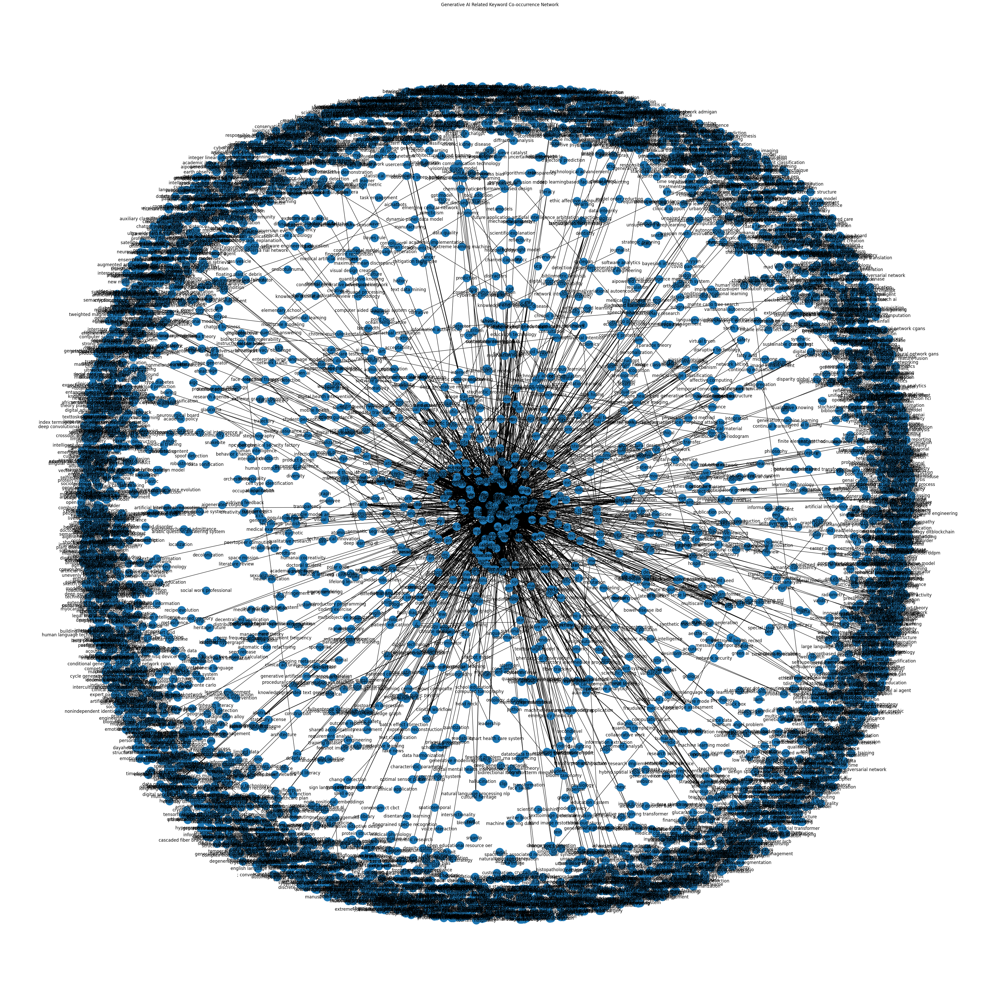

In [ ]:
# Visualizing the nodes with weight more than 1
# Nodes
plt.figure(figsize=(50, 50))
nx.draw_networkx_nodes(G, pos, node_size=500)

# Edges
edges = [(u, v, d) for u, v, d in G.edges(data=True) if d['weight'] > 1]
edge_width = [d['weight']*0.5 for _, _, d in edges]  # Scale edge widths by weight
nx.draw_networkx_edges(G, pos, edgelist=edges, width=edge_width)

# Labels
nx.draw_networkx_labels(G, pos, font_size=12)
# Highlight the strongest node
# strongest_node = max(G.nodes(), key=lambda x: G.degree(x))
# nx.draw_networkx_nodes(G, pos, nodelist=[strongest_node], node_size=500, node_color='red', alpha=0.5)

plt.title("Generative AI Related Keyword Co-occurrence Network")
plt.axis('off')
plt.show()

In [ ]:
# Calculate degrees of all nodes
node_degrees = dict(G.degree())

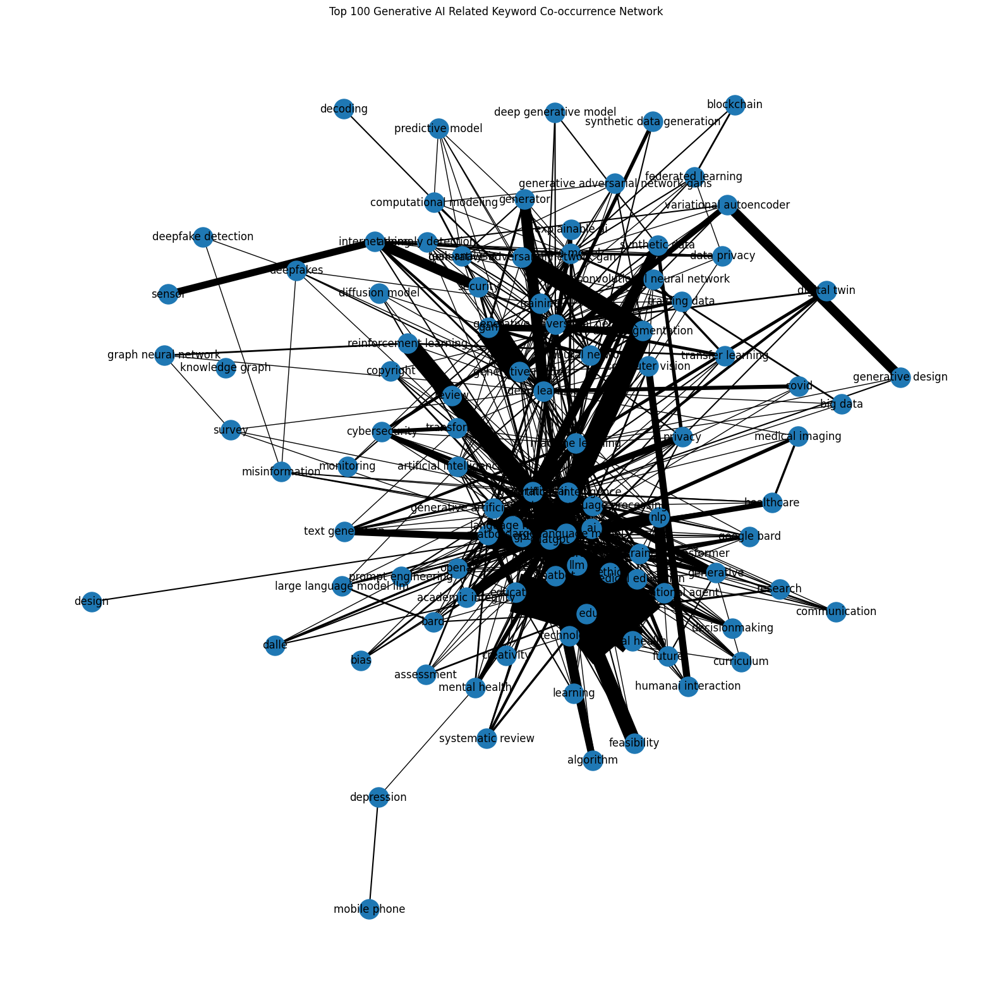

In [ ]:
# Get the top 100 nodes with the highest degrees
top_100_nodes = heapq.nlargest(100, node_degrees, key=node_degrees.get)

# Define the edges variable in the current cell
edges = [(u, v, d) for u, v, d in G_top.edges(data=True) if d['weight'] > 1]

# Create a subgraph with only the top nodes
G_top = G.subgraph(top_100_nodes)

# Create a Fruchterman-Reingold layout for the graph
pos = nx.spring_layout(G_top, k=0.15)

# Nodes
plt.figure(figsize=(20, 20))  # Adjust the figure size as needed
nx.draw_networkx_nodes(G_top, pos, node_size=500)

# Edges
nx.draw_networkx_edges(G_top, pos, edgelist=edges, width=edge_width)

# Labels
nx.draw_networkx_labels(G_top, pos, font_size=12)

plt.title("Top 100 Generative AI Related Keyword Co-occurrence Network")
plt.axis('off')
plt.show()

In [40]:
# Calculate and display the degree of each node in the network
node_degrees = {node: G.degree(node) for node in G.nodes()}
node_degrees_sorted = sorted(node_degrees.items(), key=lambda x: x[1], reverse=True)

node_degrees_sorted

[('artificial intelligence', 1276),
 ('chatgpt', 992),
 ('generative ai', 962),
 ('deep learning', 645),
 ('generative adversarial network', 573),
 ('machine learning', 491),
 ('large language model', 464),
 ('ai', 363),
 ('gpt', 332),
 ('generative model', 298),
 ('generative artificial intelligence', 237),
 ('natural language processing', 217),
 ('training', 209),
 ('chatbot', 185),
 ('chatbots', 179),
 ('artificial intelligence ai', 178),
 ('transformer', 172),
 ('education', 170),
 ('gan', 170),
 ('llm', 155),
 ('task analysis', 146),
 ('language model', 140),
 ('data model', 137),
 ('generative pretrained transformer', 129),
 ('generative adversarial network gan', 128),
 ('neural network', 127),
 ('ethic', 122),
 ('medical education', 122),
 ('data augmentation', 118),
 ('openai', 103),
 ('higher education', 103),
 ('anomaly detection', 101),
 ('generator', 101),
 ('generative', 98),
 ('creativity', 95),
 ('technology', 93),
 ('nlp', 92),
 ('diffusion model', 90),
 ('bard', 87),
 

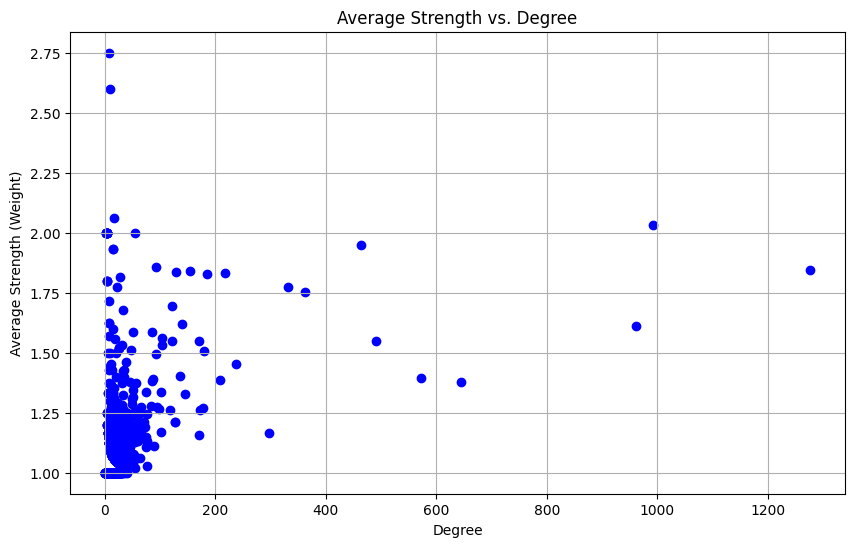

In [41]:
# Calculate average strength (average weight) for each node
average_strength = {node: 0 for node in G.nodes()}
for node in G.nodes():
    total_weight = sum([attr['weight'] for _, _, attr in G.edges(node, data=True)])
    average_strength[node] = total_weight / G.degree(node)

# Extract degree and average strength for each node
degrees = [G.degree(node) for node in G.nodes()]
average_strengths = [average_strength[node] for node in G.nodes()]

# Plotting
plt.figure(figsize=(10, 6))
plt.scatter(degrees, average_strengths, color='blue')
plt.title("Average Strength vs. Degree")
plt.xlabel("Degree")
plt.ylabel("Average Strength (Weight)")
plt.grid(True)
plt.show()


***Task 3: Identification of Key Research Themes***

From the provided data showing relationships between various terms and their weights, we can derive several insights about the generative AI landscape

**Major Players:**
- As indicated by their high weights and frequent appearance in connections to other terms, terms like "chatgpt," "generative AI," "large language model," and "artificial intelligence" have significance to the generative AI area. These words stand for core ideas and innovations in the industry.

**Broad Links:**
- The relationships among "artificial intelligence," "deep learning," "machine learning," and "natural language processing" emphasize the multidisciplinary character of generative artificial intelligence research. These connections highlight how different AI approaches and techniques are integrated in generative AI applications.

**Use Cases and Applications:**
- Words like "chatbot," "medical education," "education," and "language model" suggest a variety of generative AI applications across various fields. The relationships cover a wide range of use cases, from language modeling and medical applications to conversational agents and educational resources.

**Future Trends:**
- Terms like "data augmentation" and "medical education" have connections that point to potential directions for future research in the field of generative artificial intelligence. These correlations might be related to new uses, changing research priorities, or developing field difficulties.

**Educational Collaborations:**
- Phrases like "openai," "training," and specific models are associated with each other, indicating that academic institutions, industrial partners, and AI development companies are working together. In order to advance generative AI technology and promote innovation in the field, collaborative efforts are essential.